Could only be run on collab with TF 2.8 and Protobuf 3.20.3, sometimes it doesnt work or run properly because trouble with dependency.

In [ ]:
!pip uninstall Cython -y
!git clone --depth 1 https://github.com/tensorflow/models

Found existing installation: Cython 3.0.11
Uninstalling Cython-3.0.11:
  Successfully uninstalled Cython-3.0.11
Cloning into 'models'...
remote: Enumerating objects: 4305, done.
remote: Counting objects: 100% (4305/4305), done.
remote: Compressing objects: 100% (3314/3314), done.
remote: Total 4305 (delta 1212), reused 2209 (delta 918), pack-reused 0 (from 0)
Receiving objects: 100% (4305/4305), 53.16 MiB | 26.65 MiB/s, done.
Resolving deltas: 100% (1212/1212), done.


In [ ]:
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.

In [ ]:
import re
with open('/content/models/research/object_detection/packages/tf2/setup.py') as f:
    s = f.read()

with open('/content/models/research/setup.py', 'w') as f:
    # Set fine_tune_checkpoint path
    s = re.sub('tf-models-official>=2.5.1',
               'tf-models-official==2.8.0', s)
    f.write(s)

In [ ]:
!pip install pyyaml==5.3
!pip install /content/models/research/
!pip install tensorflow_io==0.23.1
!wget https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/cuda-ubuntu1804.pin
!mv cuda-ubuntu1804.pin /etc/apt/preferences.d/cuda-repository-pin-600
!wget http://developer.download.nvidia.com/compute/cuda/11.0.2/local_installers/cuda-repo-ubuntu1804-11-0-local_11.0.2-450.51.05-1_amd64.deb
!dpkg -i cuda-repo-ubuntu1804-11-0-local_11.0.2-450.51.05-1_amd64.deb
!apt-key add /var/cuda-repo-ubuntu1804-11-0-local/7fa2af80.pub
!apt-get update && sudo apt-get install cuda-toolkit-11-0
!export LD_LIBRARY_PATH=/usr/local/cuda-11.0/lib64:$LD_LIBRARY_PATH

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.2/268.2 kB 8.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.3-cp310-cp310-linux_x86_64.whl size=44244 sha256=01e97d0bca886834804ad26bd65c65f52b2ac3a23496b848c7c0845dfd251c95
  Stored in directory: /root/.cache/pip/wheels/0d/72/68/a263cfc14175636cf26bada99f13b735be1b60a11318e08bfc
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0.2
    Uninstalling PyYAML-6.0.2:
      Successfully uninstalled PyYAML-6.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2024.10.0 requires pyyaml>=5.3.1, but you have pyyaml 5.3 which is incompatible.
flax 0.8.5 requires PyYAML>=5.4.1, but you have pyyaml 5.3 which is incompatible.
Processing ./models/research
  Preparing metadata (setup.py) ... done
  Preparing metadat

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.1/23.1 MB 84.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 87.0 MB/s eta 0:00:00
  Attempting uninstall: tensorflow-io-gcs-filesystem
    Found existing installation: tensorflow-io-gcs-filesystem 0.37.1
    Uninstalling tensorflow-io-gcs-filesystem-0.37.1:
      Successfully uninstalled tensorflow-io-gcs-filesystem-0.37.1
  Attempting uninstall: tensorflow_io
    Found existing installation: tensorflow-io 0.37.1
    Uninstalling tensorflow-io-0.37.1:
      Successfully uninstalled tensorflow-io-0.37.1
--2024-12-07 07:07:49--  https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/cuda-ubuntu1804.pin
Resolving developer.download.nvidia.com (developer.download.nvidia.com)... 152.195.19.142
Connecting to developer.download.nvidia.com (developer.download.nvidia.com)|152.195.19.142|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 190 [application/octet-stream]
Saving to: ‘

In [ ]:
!pip install protobuf==3.20.3 --force-reinstall

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 15.4 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 4.25.5
    Uninstalling protobuf-4.25.5:
      Successfully uninstalled protobuf-4.25.5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
grpcio-status 1.62.3 requires protobuf>=4.21.6, but you have protobuf 3.20.3 which is incompatible.
pandas-gbq 0.24.0 requires google-auth-oauthlib>=0.7.0, but you have google-auth-oauthlib 0.4.6 which is incompatible.


In [ ]:
!python /content/models/research/object_detection/builders/model_builder_tf2_test.py

Running tests under Python 3.10.12: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_deepmac
2024-12-07 07:12:44.800470: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
W1207 07:12:45.144360 138122062069760 model_builder.py:1112] Building experimental DeepMAC meta-arch. Some features may be omitted.
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 3.07s
I1207 07:12:45.710609 138122062069760 test_util.py:2373] time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 3.07s
[       OK ] ModelBuilderTF2Test.test_create_center_net_deepmac
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)): 0.79s
I1207 07:12:46.503553 138122062069760 tes

### Model pipeline

In [ ]:
train_record_fname = '/content/train.record'
val_record_fname = '/content/val.record'
label_map_pbtxt_fname = '/content/label_map.pbtxt'
batch_size = 16
num_steps = 40000

In [ ]:
%mkdir /content/models/mymodel/
%cd /content/models/mymodel/

import tarfile
download_tar = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz'
!wget {download_tar}
tar = tarfile.open('ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz')
tar.extractall()
tar.close()

download_config = 'https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config'
!wget {download_config}

mkdir: cannot create directory ‘/content/models/mymodel/’: No such file or directory
[Errno 2] No such file or directory: '/content/models/mymodel/'
/content
--2024-12-07 06:50:11--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 172.217.204.207, 172.217.203.207, 142.250.98.207, ...
Connecting to download.tensorflow.org (download.tensorflow.org)|172.217.204.207|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 20515344 (20M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_fp 100%[===================>]  19.56M   115MB/s    in 0.2s    

2024-12-07 06:50:11 (115 MB/s) - ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’ saved [20515344/20515344]

--2024-12-07 06:50:11--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mo

In [ ]:
fine_tune_checkpoint = '/content/models/mymodel/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/ckpt-0'

def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())
num_classes = get_num_classes(label_map_pbtxt_fname)
print('Total classes:', num_classes)

In [ ]:
import re

%cd /content/models/mymodel
print('writing custom configuration file')

with open('/content/models/mymodel/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config') as f:
    s = f.read()
with open('pipeline_file.config', 'w') as f:
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)

    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 'input_path: "{}"'.format(val_record_fname), s)

    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)

    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)

    s = re.sub(
        'fine_tune_checkpoint_type: "classification"', 'fine_tune_checkpoint_type: "{}"'.format('detection'), s)

    f.write(s)

/content/models/mymodel
writing custom configuration file


In [ ]:
!cat /content/models/mymodel/pipeline_file.config

# SSD with Mobilenet v2 FPN-lite (go/fpn-lite) feature extractor, shared box
# predictor and focal loss (a mobile version of Retinanet).
# Retinanet: see Lin et al, https://arxiv.org/abs/1708.02002
# Trained on COCO, initialized from Imagenet classification checkpoint
# Train on TPU-8
#
# Achieves 22.2 mAP on COCO17 Val

model {
  ssd {
    inplace_batchnorm_update: true
    freeze_batchnorm: false
    num_classes: 69
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    encode_background_as_zeros: true
    anchor_generator {
      multiscale_anchor_generator 

In [ ]:
pipeline_file = '/content/models/mymodel/pipeline_file.config'
model_dir = '/content/training/'

### Training

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/training/train'

<IPython.core.display.Javascript object>

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1

/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.13.0 and strictly below 2.16.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.8.1 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're us

### Continue Training

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!cp '/content/drive/MyDrive/Capstone Project/ML/Dataset/Model 1 - Kulkas/Hasil.zip' /content/
!cp '/content/drive/MyDrive/Capstone Project/ML/Dataset/Model 1 - Kulkas/ccurrent.zip' /content/

In [ ]:
!cp '/content/drive/MyDrive/Capstone Project/ML/Dataset/Model 1 - Kulkas/pipeline_file.config' /content/

In [ ]:
!unzip '/content/ccurrent.zip'
!unzip '/content/Hasil.zip'

Archive:  /content/ccurrent.zip
   creating: training/
  inflating: training/ckpt-8.data-00000-of-00001  
  inflating: training/ckpt-7.data-00000-of-00001  
  inflating: training/ckpt-9.data-00000-of-00001  
  inflating: training/ckpt-5.data-00000-of-00001  
  inflating: training/ckpt-7.index   
  inflating: training/ckpt-5.index   
  inflating: training/ckpt-4.data-00000-of-00001  
  inflating: training/ckpt-9.index   
  inflating: training/ckpt-4.index   
  inflating: training/checkpoint     
  inflating: training/ckpt-6.index   
  inflating: training/ckpt-10.data-00000-of-00001  
   creating: training/train/
  inflating: training/train/events.out.tfevents.1733541559.8d3377010810.6055.0.v2  
  inflating: training/ckpt-8.index   
  inflating: training/ckpt-10.index  
  inflating: training/ckpt-6.data-00000-of-00001  
Archive:  /content/Hasil.zip
  inflating: labelmap.txt            
  inflating: label_map.pbtxt         
  inflating: test.record             
  inflating: train.record  

In [ ]:
import re
fine_tune_checkpoint = '/content/training/ckpt-10'
pipeline_fname = '/content/pipeline_file.config'
with open(pipeline_fname) as f:
    s = f.read()
with open('pipeline_file.config', 'w') as f:
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)

    f.write(s)

In [ ]:
!cat /content/pipeline_file.config

# SSD with Mobilenet v2 FPN-lite (go/fpn-lite) feature extractor, shared box
# predictor and focal loss (a mobile version of Retinanet).
# Retinanet: see Lin et al, https://arxiv.org/abs/1708.02002
# Trained on COCO, initialized from Imagenet classification checkpoint
# Train on TPU-8
#
# Achieves 22.2 mAP on COCO17 Val

model {
  ssd {
    inplace_batchnorm_update: true
    freeze_batchnorm: false
    num_classes: 69
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    encode_background_as_zeros: true
    anchor_generator {
      multiscale_anchor_generator 

In [ ]:
pipeline_file = '/content/pipeline_file.config'
model_dir = '/content/training2/'
num_steps = 40000

#### now training starts here

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/training2/train'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1

/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.13.0 and strictly below 2.16.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.8.1 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're us

### COnvert ke TF lite

In [ ]:
!mkdir /content/custom_model_lite
output_directory = '/content/custom_model_lite'

last_model_path = '/content/training2'

!python /content/models/research/object_detection/export_tflite_graph_tf2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}


2024-12-07 09:16:15.412976: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
I1207 09:16:19.193159 138797785796608 api.py:441] feature_map_spatial_dims: [(40, 40), (20, 20), (10, 10), (5, 5), (3, 3)]
I1207 09:16:24.438701 138797785796608 api.py:441] feature_map_spatial_dims: [(40, 40), (20, 20), (10, 10), (5, 5), (3, 3)]
2024-12-07 09:16:26.979455: W tensorflow/python/util/util.cc:368] Sets are not currently considered sequences, but this may change in the future, so consider avoiding using them.
I1207 09:16:27.897049 138797785796608 api.py:441] feature_map_spatial_dims: [(40, 40), (20, 20), (10, 10), (5, 5), (3, 3)]
W1207 09:16:29.418664 138797785796608 save_impl.py:71] Skipping full serialization of Keras layer <object_detection.meta_architectures.ssd_meta_arch.SSDMetaArch object at 0x7e3beac9c340>, because it is not built.
W1207 09:16:29.666978

In [ ]:
import tensorflow as tf

converter = tf.lite.TFLiteConverter.from_saved_model('/content/custom_model_lite/saved_model')
tflite_model = converter.convert()

with open('/content/custom_model_lite/detect.tflite', 'wb') as f:
  f.write(tflite_model)

In [ ]:
!cp /content/label_map.pbtxt /content/custom_model_lite
!cp /content/labelmap.txt /content/custom_model_lite
!cp /content/models/mymodel/pipeline_file.config /content/custom_model_lite
%cd /content
!zip -r custom_model_lite.zip custom_model_lite

cp: cannot stat '/content/models/mymodel/pipeline_file.config': No such file or directory
/content
  adding: custom_model_lite/ (stored 0%)
  adding: custom_model_lite/label_map.pbtxt (deflated 78%)
  adding: custom_model_lite/detect.tflite (deflated 9%)
  adding: custom_model_lite/saved_model/ (stored 0%)
  adding: custom_model_lite/saved_model/saved_model.pb (deflated 91%)
  adding: custom_model_lite/saved_model/assets/ (stored 0%)
  adding: custom_model_lite/saved_model/variables/ (stored 0%)
  adding: custom_model_lite/saved_model/variables/variables.data-00000-of-00001 (deflated 8%)
  adding: custom_model_lite/saved_model/variables/variables.index (deflated 78%)
  adding: custom_model_lite/labelmap.txt (deflated 44%)


In [ ]:
%cd /content
!zip -r custom_model_lite.zip custom_model_lite

/content
updating: custom_model_lite/ (stored 0%)
updating: custom_model_lite/label_map.pbtxt (deflated 78%)
updating: custom_model_lite/detect.tflite (deflated 9%)
updating: custom_model_lite/saved_model/ (stored 0%)
updating: custom_model_lite/saved_model/saved_model.pb (deflated 91%)
updating: custom_model_lite/saved_model/assets/ (stored 0%)
updating: custom_model_lite/saved_model/variables/ (stored 0%)
updating: custom_model_lite/saved_model/variables/variables.data-00000-of-00001 (deflated 8%)
updating: custom_model_lite/saved_model/variables/variables.index (deflated 78%)
updating: custom_model_lite/labelmap.txt (deflated 44%)


In [ ]:
%cd /content
!zip -r current.zip training2

/content
  adding: training2/ (stored 0%)
  adding: training2/ckpt-11.index (deflated 82%)
  adding: training2/ckpt-13.data-00000-of-00001 (deflated 7%)
  adding: training2/ckpt-8.data-00000-of-00001 (deflated 7%)
  adding: training2/ckpt-9.data-00000-of-00001 (deflated 8%)
  adding: training2/ckpt-14.data-00000-of-00001 (deflated 7%)
  adding: training2/ckpt-14.index (deflated 82%)
  adding: training2/ckpt-9.index (deflated 82%)
  adding: training2/ckpt-12.index (deflated 82%)
  adding: training2/checkpoint (deflated 75%)
  adding: training2/ckpt-11.data-00000-of-00001 (deflated 7%)
  adding: training2/ckpt-10.data-00000-of-00001 (deflated 7%)
  adding: training2/train/ (stored 0%)
  adding: training2/train/events.out.tfevents.1733555724.a9ec7036a0bb.7180.0.v2 (deflated 8%)
  adding: training2/train/events.out.tfevents.1733555790.a9ec7036a0bb.7564.0.v2 (deflated 0%)
  adding: training2/ckpt-8.index (deflated 82%)
  adding: training2/ckpt-13.index (deflated 82%)
  adding: training2/ckp

### Inference Test

In [ ]:
import os
import cv2
import numpy as np
import sys
import glob
import random
import importlib.util
from tensorflow.lite.python.interpreter import Interpreter

import matplotlib
import matplotlib.pyplot as plt

%matplotlib inline

def tflite_detect_images(modelpath, imgpath, lblpath, min_conf=0.5, num_test_images=10, savepath='/content/results', txt_only=False):

  images = glob.glob(imgpath + '/*.jpg') + glob.glob(imgpath + '/*.JPG') + glob.glob(imgpath + '/*.png') + glob.glob(imgpath + '/*.bmp')

  with open(lblpath, 'r') as f:
      labels = [line.strip() for line in f.readlines()]

  interpreter = Interpreter(model_path=modelpath)
  interpreter.allocate_tensors()
  input_details = interpreter.get_input_details()
  output_details = interpreter.get_output_details()
  height = input_details[0]['shape'][1]
  width = input_details[0]['shape'][2]
  float_input = (input_details[0]['dtype'] == np.float32)
  input_mean = 127.5
  input_std = 127.5

  images_to_test = random.sample(images, num_test_images)

  for image_path in images_to_test:

      image = cv2.imread(image_path)
      image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      imH, imW, _ = image.shape
      image_resized = cv2.resize(image_rgb, (width, height))
      input_data = np.expand_dims(image_resized, axis=0)
      if float_input:
          input_data = (np.float32(input_data) - input_mean) / input_std
      interpreter.set_tensor(input_details[0]['index'],input_data)
      interpreter.invoke()
      boxes = interpreter.get_tensor(output_details[1]['index'])[0]
      classes = interpreter.get_tensor(output_details[3]['index'])[0]
      scores = interpreter.get_tensor(output_details[0]['index'])[0]
      detections = []

      for i in range(len(scores)):
          if ((scores[i] > min_conf) and (scores[i] <= 1.0)):
              ymin = int(max(1,(boxes[i][0] * imH)))
              xmin = int(max(1,(boxes[i][1] * imW)))
              ymax = int(min(imH,(boxes[i][2] * imH)))
              xmax = int(min(imW,(boxes[i][3] * imW)))

              cv2.rectangle(image, (xmin,ymin), (xmax,ymax), (10, 255, 0), 2)
              object_name = labels[int(classes[i])]
              label = '%s: %d%%' % (object_name, int(scores[i]*100))
              labelSize, baseLine = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.7, 2)
              label_ymin = max(ymin, labelSize[1] + 10)
              cv2.rectangle(image, (xmin, label_ymin-labelSize[1]-10), (xmin+labelSize[0], label_ymin+baseLine-10), (255, 255, 255), cv2.FILLED)
              cv2.putText(image, label, (xmin, label_ymin-7), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 0), 2)
              detections.append([object_name, scores[i], xmin, ymin, xmax, ymax])

      if txt_only == False:
        image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(12,16))
        plt.imshow(image)
        plt.show()
      elif txt_only == True:
        image_fn = os.path.basename(image_path)
        base_fn, ext = os.path.splitext(image_fn)
        txt_result_fn = base_fn +'.txt'
        txt_savepath = os.path.join(savepath, txt_result_fn)


        with open(txt_savepath,'w') as f:
            for detection in detections:
                f.write('%s %.4f %d %d %d %d\n' % (detection[0], detection[1], detection[2], detection[3], detection[4], detection[5]))

  return

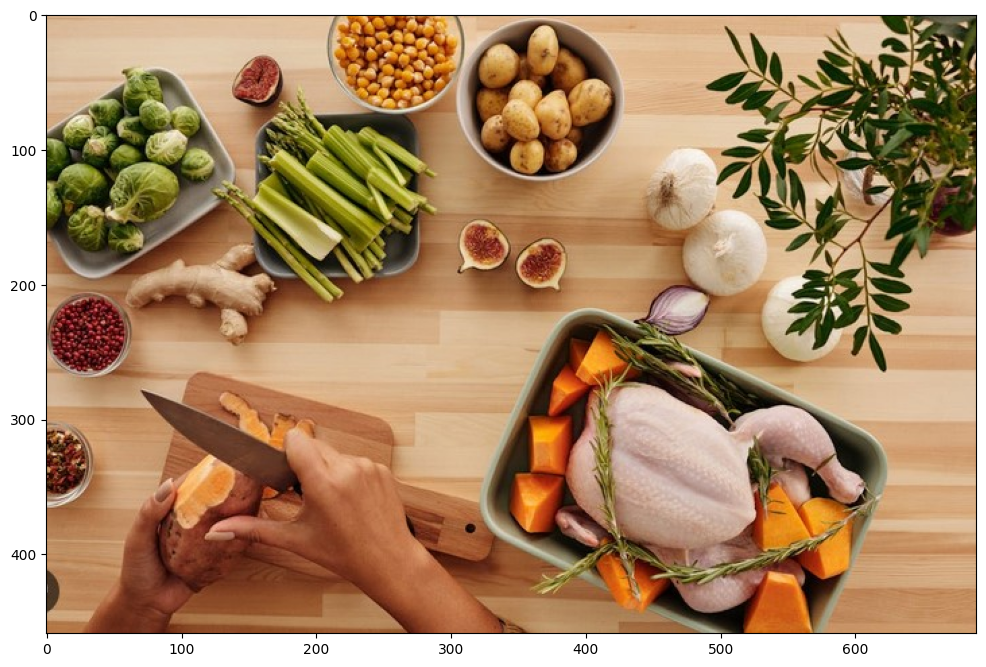

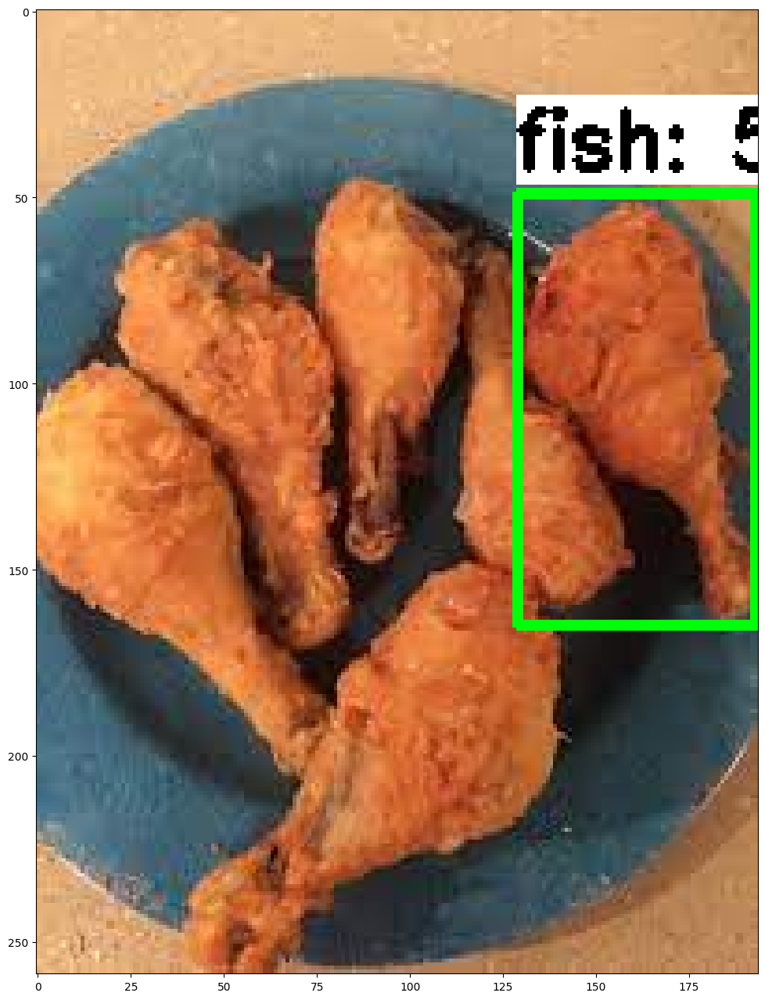

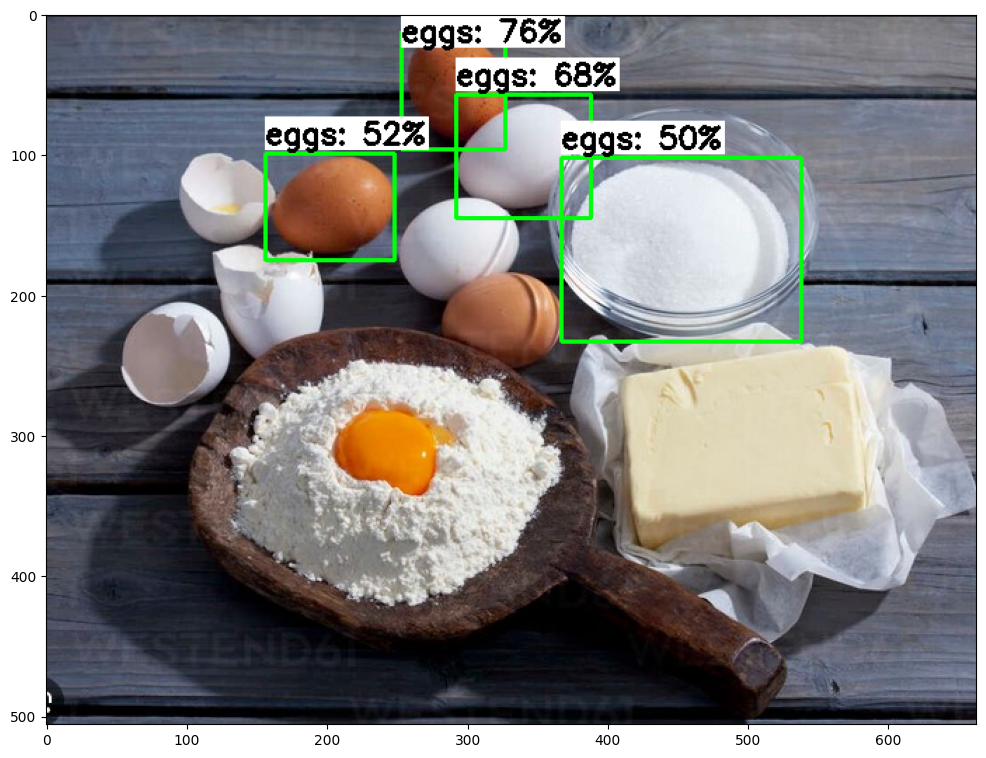

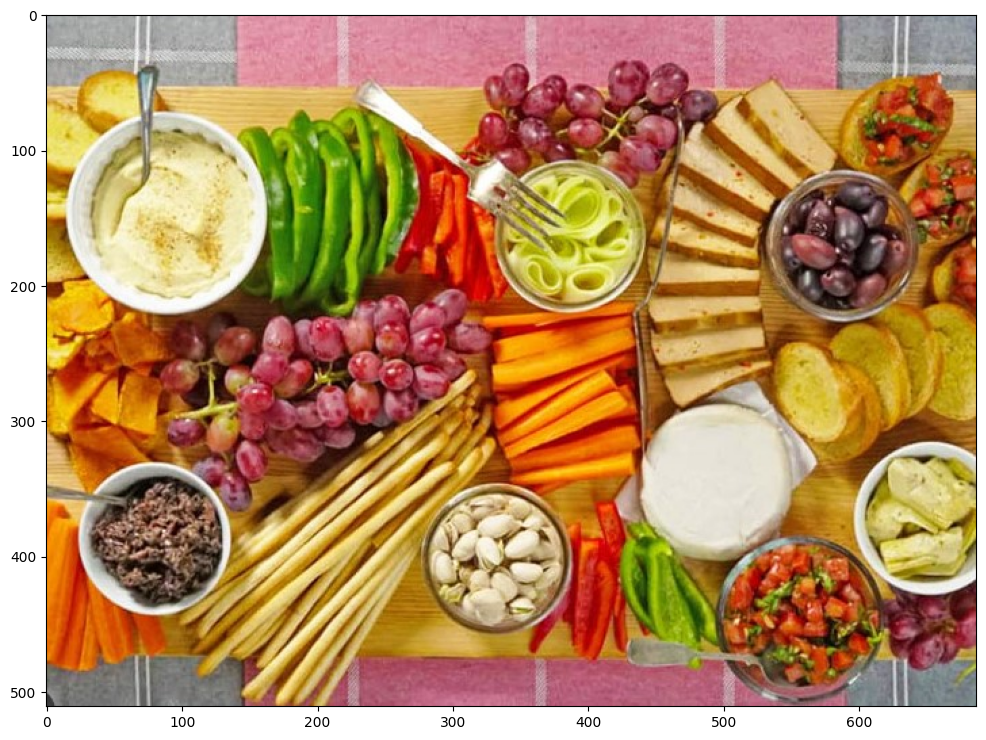

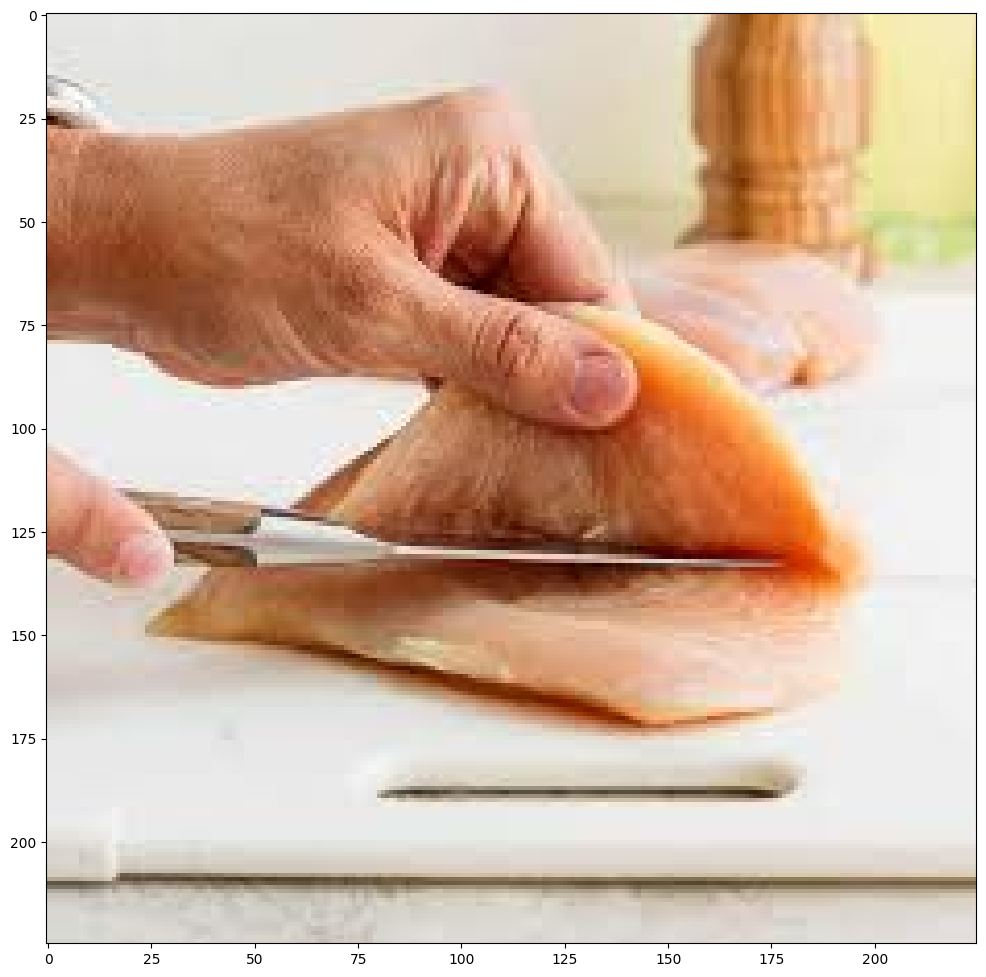

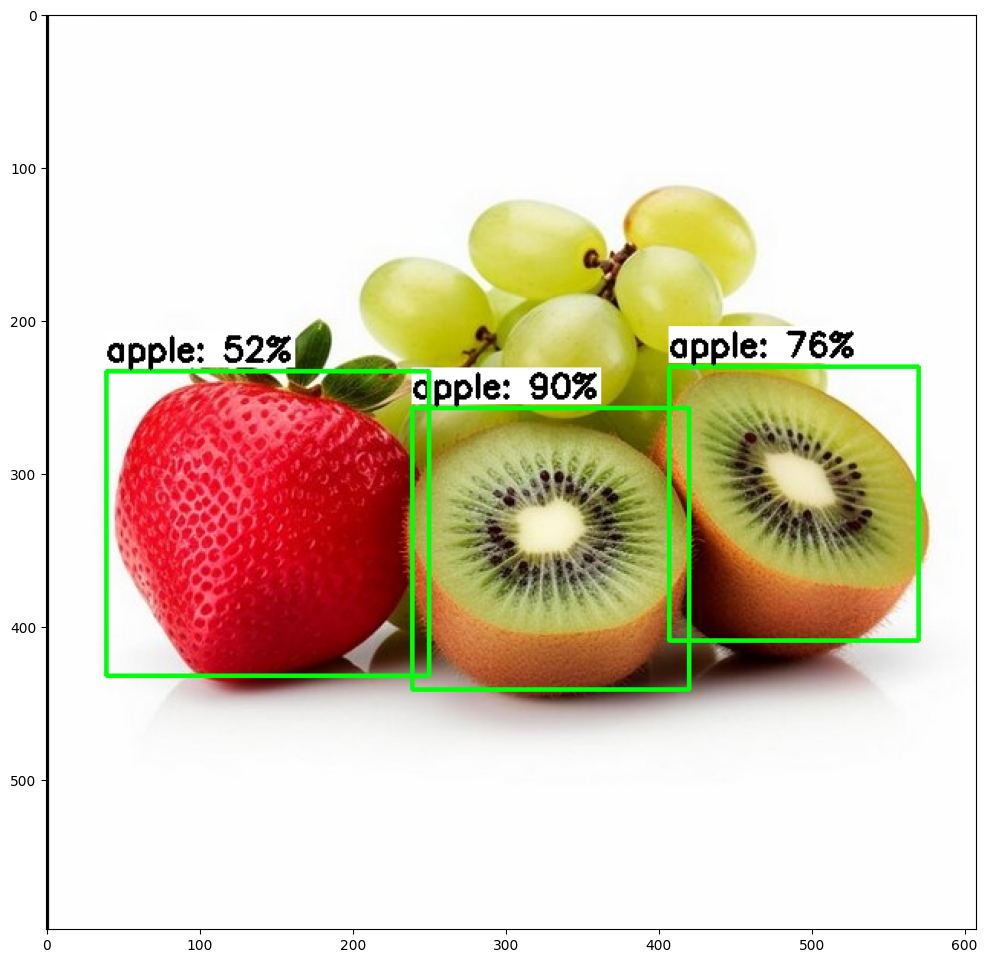

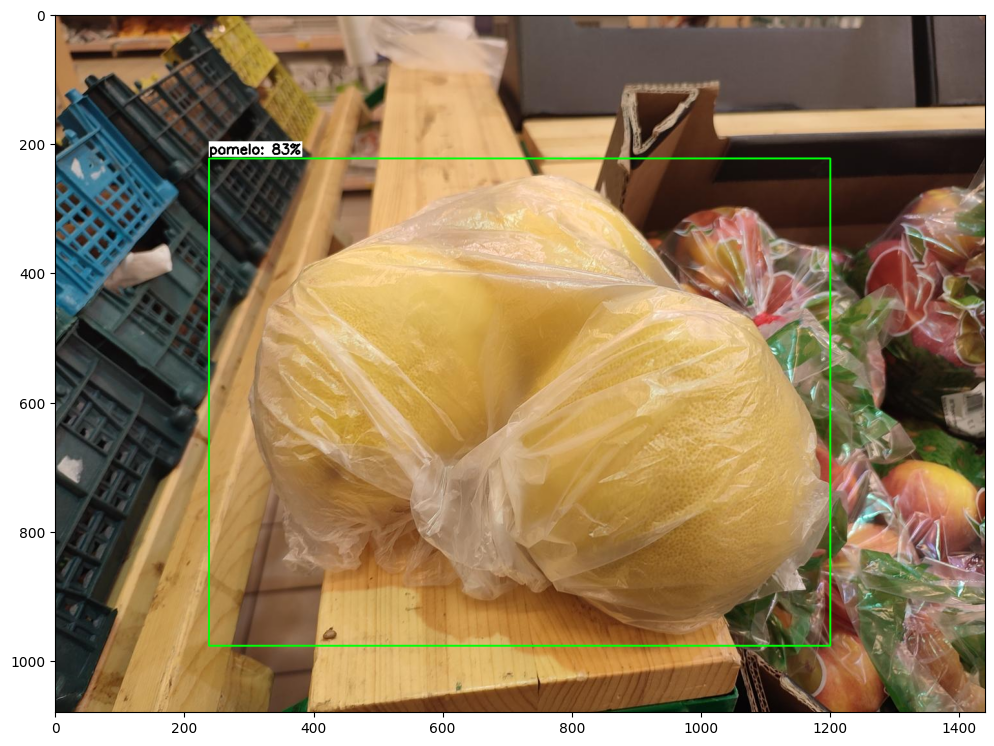

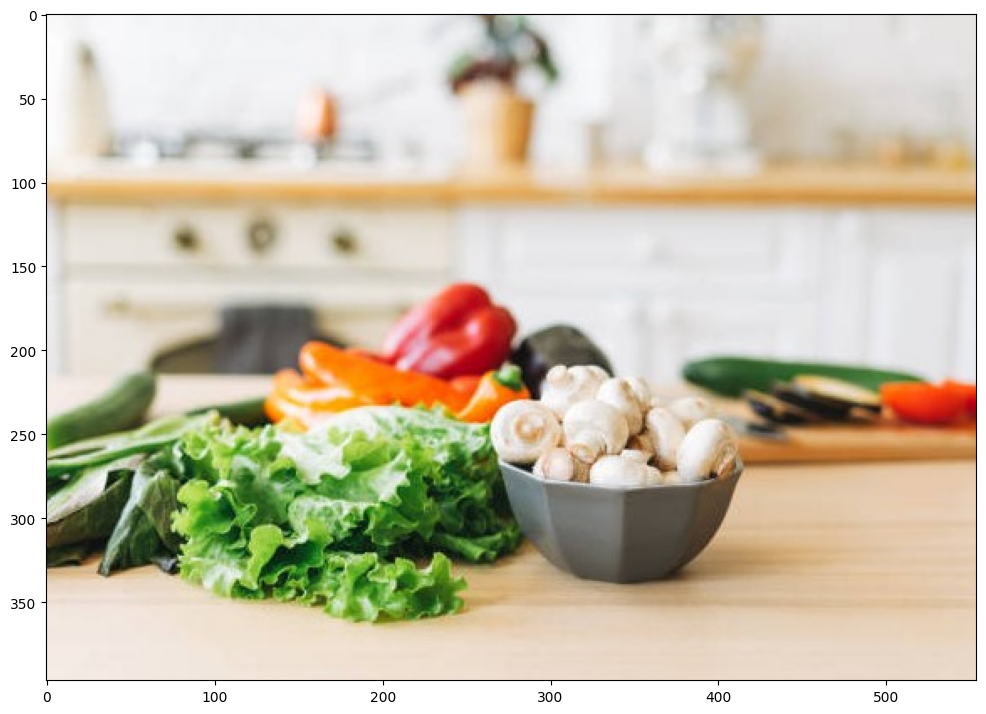

In [ ]:
PATH_TO_IMAGES='/content/images/test'
PATH_TO_MODEL='/content/custom_model_lite/detect.tflite'
PATH_TO_LABELS='/content/labelmap.txt'
min_conf_threshold=0.5
images_to_test = 8

tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test)

In [ ]:
!cp current.zip "/content/drive/MyDrive/Capstone Project/ML/Dataset/Model 1 - Kulkas